<a href="https://colab.research.google.com/github/CAR-Driving/yoloOnGoogleColab/blob/master/object_detection_method2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [ ]:
!pip install tensorflow-object-detection-api

In [3]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
import pathlib

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [4]:
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

In [5]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))
  model = model.signatures['serving_default']

  return model

In [7]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [8]:
model_name = 'ssd_mobilenet_v1_coco_2017_11_17'
detection_model = load_model(model_name)

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [9]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  output_dict = model(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [12]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = image_path
  image_np=cv2.cvtColor(image_np,cv2.COLOR_BGR2RGB)
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=2)
  image_np=cv2.cvtColor(image_np,cv2.COLOR_BGR2RGB)
  person_detect(image_np,output_dict['detection_classes'],output_dict['detection_scores'],output_dict['detection_boxes'])
  return image_np

In [13]:
!mkdir /content/image_results_4rom_boxes

In [14]:
from datetime import datetime

def person_detect(image,classes,score,boxes):
    
    for i in range(10):
        if(classes[i]==1 and score[i]>0.8):
            
            h,w=image.shape[0:2]
            #image.shape=[height,width,3]
            
            ymin,xmin,ymax,xmax=boxes[i]

            now = datetime.now()
            dt_string = now.strftime("%d_%m_%Y_%H_%M_%S")
            
            center=(int(((xmin+xmax)/2)*w),int(((ymin+ymax)/2)*h))
            cv2.circle(image,center,10,(0,0,255),-1)
            
            file_name=os.path.join('/content/image_results_4rom_boxes',dt_string+'.jpg')
            cv2.imwrite(file_name,image)

# Building the database by scraping the video of each car type and save yolo detection result as car type for database

We are going to Make databases on the following YouTube video:

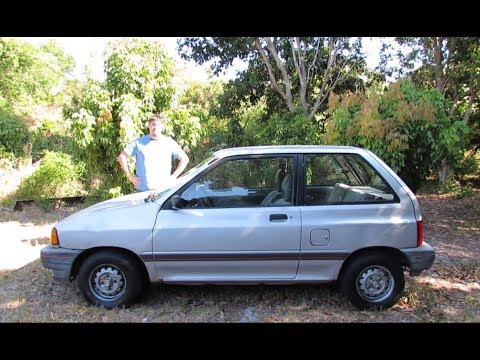

In [15]:
!pip3 install youtube_dl 

#@title
import os
from os.path import exists, join, basename, splitext 
from IPython.display import YouTubeVideo

YOUTUBE_ID = 'xFLckB7vOQc' #(Ford Festiva)


YouTubeVideo(YOUTUBE_ID)

In [28]:
# %cd '/content/'
# %cd '/content/drive/My Drive/Torrent/'
# !rm -rf *.wav
# !youtube-dl  --output "test.%(ext)s" https://www.youtube.com/watch\?v\={YOUTUBE_ID}
!youtube-dl --format "bestvideo+bestaudio[ext=m4a]/bestvideo+bestaudio/best" --merge-output-format mp4  --postprocessor-args "-ss 0:0:00 -to 0:00:11"  --output "Ford_Festiva.%(ext)s" https://www.youtube.com/watch\?v\={YOUTUBE_ID}

# !deepspeech --model deepspeech-0.6.1-models/output_graph.pbmm --lm deepspeech-0.6.1-models/lm.binary --trie deepspeech-0.6.1-models/trie --audio test.wav   --extended --json 
!ls

[youtube] xFLckB7vOQc: Downloading webpage
[youtube] xFLckB7vOQc: Downloading MPD manifest
[dashsegments] Total fragments: 150
[download] Destination: Ford_Festiva.f137.mp4
[download] 100% of 293.88MiB in 00:19
[dashsegments] Total fragments: 81
[download] Destination: Ford_Festiva.f140.m4a
[download] 100% of 12.26MiB in 00:06
[ffmpeg] Merging formats into "Ford_Festiva.mp4"
Deleting original file Ford_Festiva.f137.mp4 (pass -k to keep)
Deleting original file Ford_Festiva.f140.m4a (pass -k to keep)
Ford_Festiva.mp4  image_results_4rom_boxes  models  sample_data


In [ ]:
# # !ffmpeg Ford_Festiva.mp4 -t 60 -c copy Ford_Festiva2.mp4
# !ffmpeg -i Ford_Festiva.mp4 -ss 00:00:03 -t 00:10:08 -async 1 Ford_Festiva2.mp4
# !ls

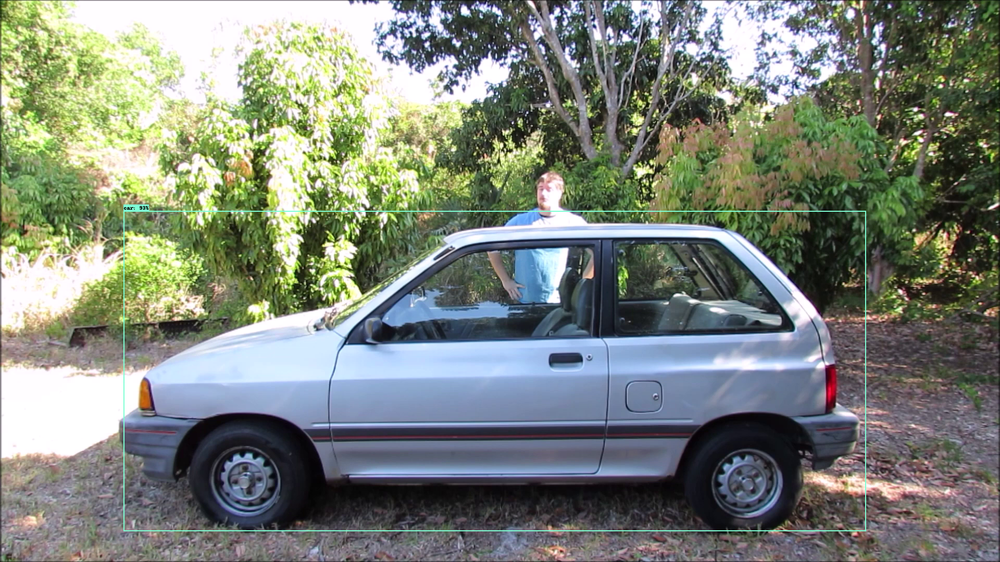

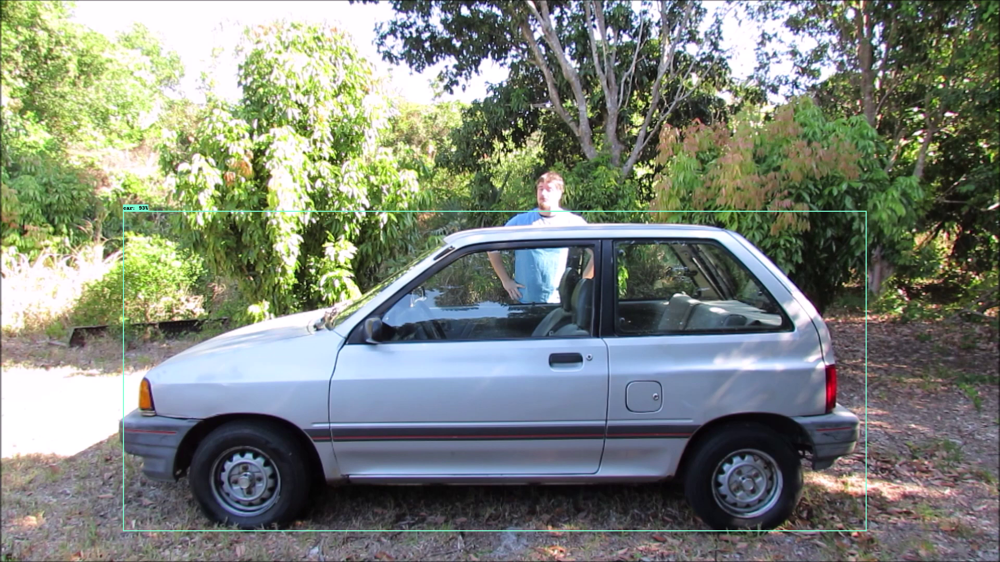

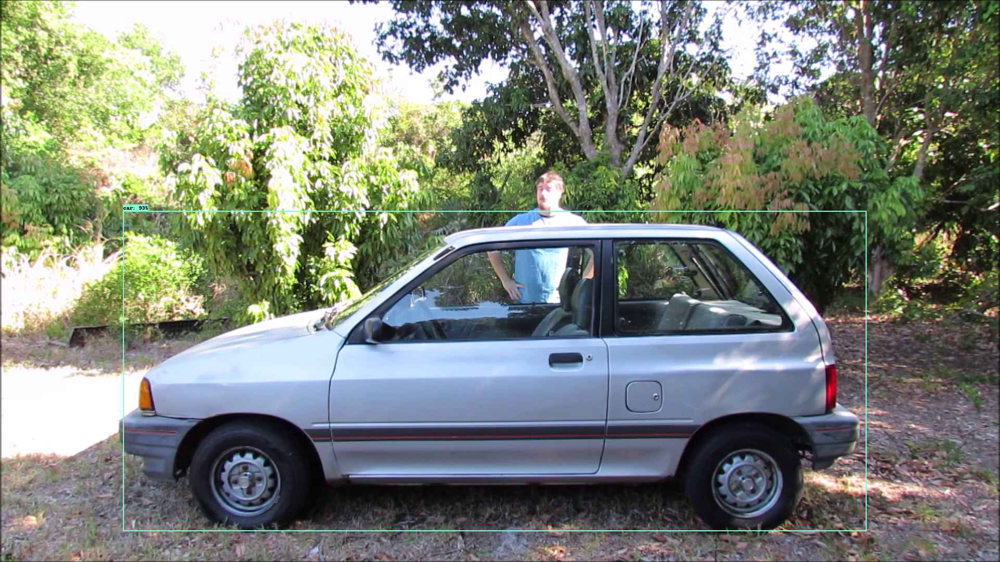

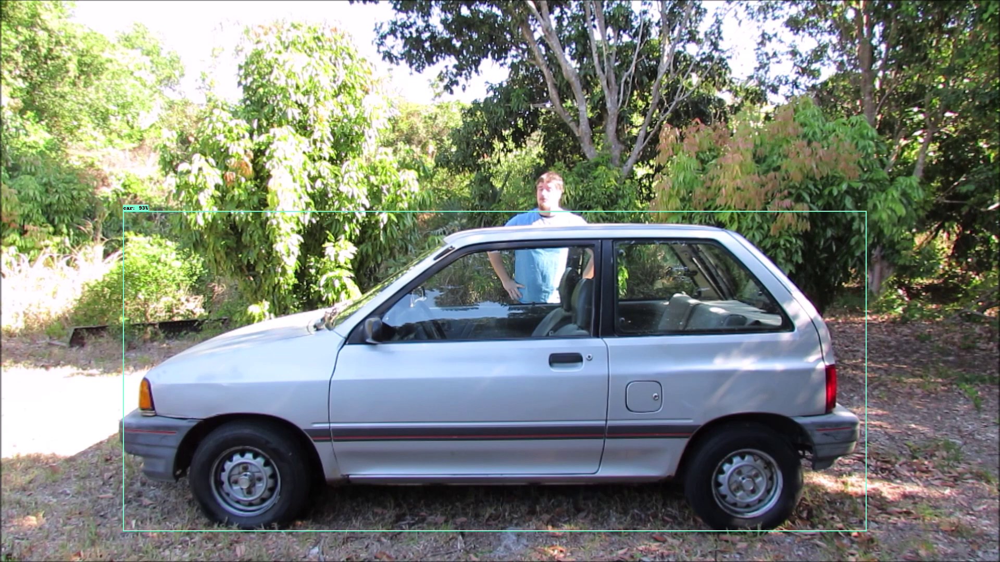

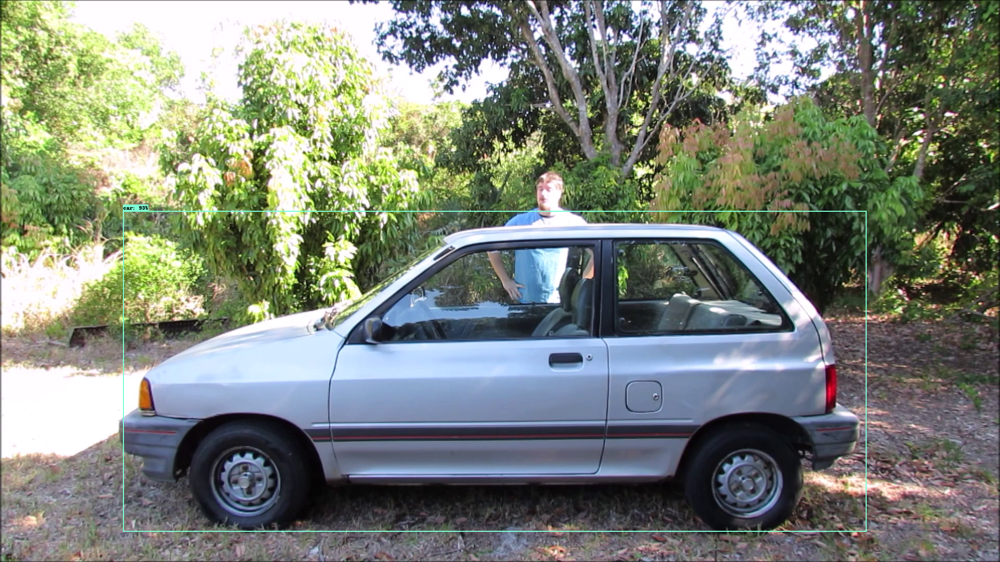

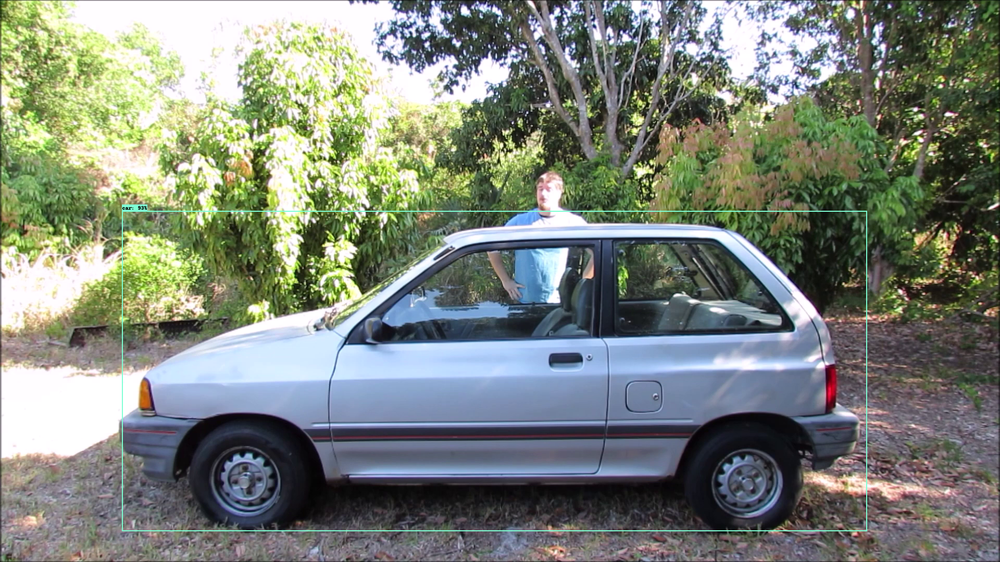

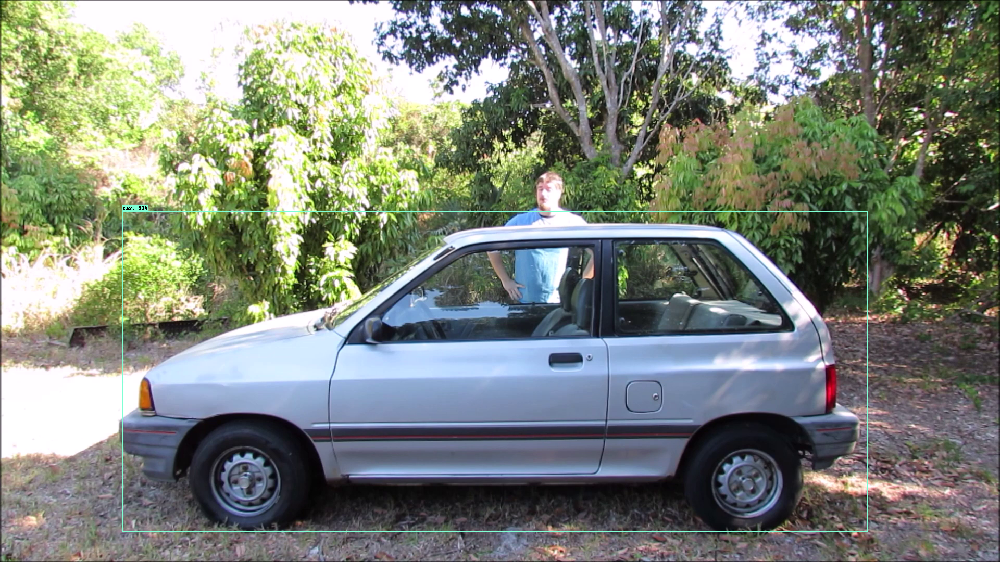

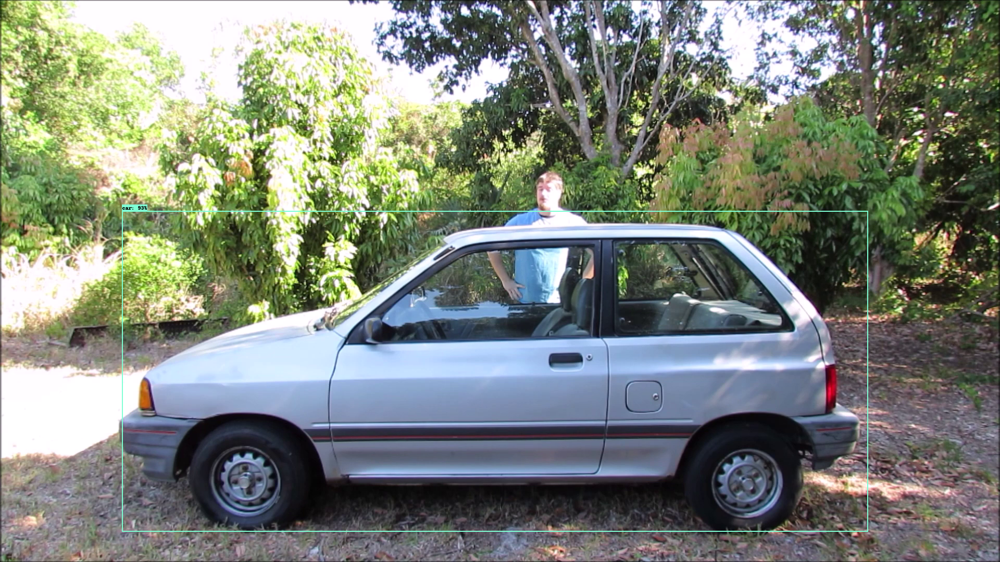

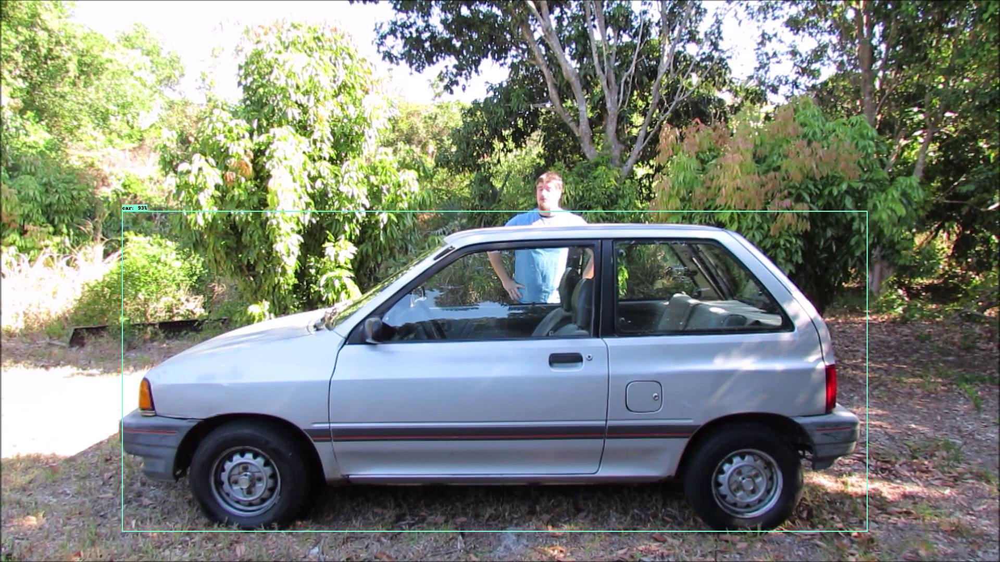

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
video=cv2.VideoCapture('/content/Ford_Festiva.mp4')

while(True):
    ret,img=video.read()
    img=show_inference(detection_model,img)
    cv2_imshow(img)
    k=cv2.waitKey(1)
    
    if(k==27):
        break
cv2.destroyAllWindows()

## ```output_dict``` 

![output_dict.png](attachment:output_dict.png)

## ```category_index```
![category%20index.png](attachment:category%20index.png)